# Сравнение различных моделей кластеризации

Случай, когда оптимальное число кластеров подбирается для каждой модели независимо.


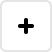
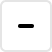
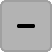
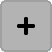
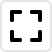
...
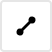
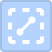
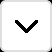
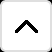
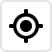

In [1]:
from itertools import product
from collections import namedtuple

import pandas as pd
from sklearn.metrics import mean_squared_error as error_metric

from lets_plot import *
from lets_plot.mapping import as_discrete
LetsPlot.setup_html()

import os; import sys; sys.path.append(os.path.join(sys.path[0], ".."))
from util import util as u
from util import font as ufont
from util import clustering_model as ucm
from util import transform_data as utd

In [2]:
FAST_RUN = False
N_CLUSTERS_MIN, N_CLUSTERS_MAX = (3, 5) if FAST_RUN else (3, 10)

In [3]:
def calc_char_general_orders(df, *, name="general_order"):
    result_s = utd.calc_char_orders(df).loc["order"]
    result_s.name = name
    return result_s

def calc_char_mean_orders(df, *, font_cols=["font_family", "font_size", "font_face"], name="mean_order"):
    result_s = utd.calc_char_orders(df, font_cols=font_cols).mean()
    result_s.name = name
    return result_s

def prepare_extended_char_data(cw_df, full_cw_df, t_s):
    c_data = ucm.prepare_char_data(cw_df, t_s)
    general_order_s = calc_char_general_orders(full_cw_df)
    mean_order_s = calc_char_mean_orders(cw_df, font_cols=["font_family"])
    general_mean_order_s = calc_char_mean_orders(full_cw_df, name="general_mean_order")
    return pd.concat([c_data, general_order_s, mean_order_s, general_mean_order_s], axis="columns")

def get_min_scored_cluster(df, *, min_coeff=2.0/3.0, model_col="model", n_clusters_col="n_clusters", score_col="score"):
    def calc_min_scored_cluster(r):
        min_value = r.max()
        for v in r.values:
            if v < min_coeff * min_value:
                min_value = v
        return min_value
    replace_s = df.sort_values(by=n_clusters_col).groupby(model_col)[score_col].agg(calc_min_scored_cluster)
    return df.score == df[model_col].replace(replace_s)

In [4]:
ModelType = namedtuple("ModelType", ["name", "clustering_col", "calc_cluster_size_method", "admixture_col"])

clustering_cols = ["width", "order", "general_order", "mean_order", "general_mean_order"]
calc_cluster_size_methods = [
    ("non_weighted", lambda r: r.width.mean()),
    ("weighted", None),
]
admixture_cols = [
    ("non_admixtured", None),
    ("admixtured", "alphabet"),
]

model_types = [
    ModelType("clustered_by_{0}-{1}-{2}".format(t[0], t[1][0], t[2][0]), t[0], t[1][1], t[2][1])
    for t in product(clustering_cols, calc_cluster_size_methods, admixture_cols)
]
if FAST_RUN:
    model_types = model_types[:8]
print("Model types:\n\t{0}".format("\n\t".join([model_type.name for model_type in model_types])))

Model types:
	clustered_by_width-non_weighted-non_admixtured
	clustered_by_width-non_weighted-admixtured
	clustered_by_width-weighted-non_admixtured
	clustered_by_width-weighted-admixtured
	clustered_by_order-non_weighted-non_admixtured
	clustered_by_order-non_weighted-admixtured
	clustered_by_order-weighted-non_admixtured
	clustered_by_order-weighted-admixtured
	clustered_by_general_order-non_weighted-non_admixtured
	clustered_by_general_order-non_weighted-admixtured
	clustered_by_general_order-weighted-non_admixtured
	clustered_by_general_order-weighted-admixtured
	clustered_by_mean_order-non_weighted-non_admixtured
	clustered_by_mean_order-non_weighted-admixtured
	clustered_by_mean_order-weighted-non_admixtured
	clustered_by_mean_order-weighted-admixtured
	clustered_by_general_mean_order-non_weighted-non_admixtured
	clustered_by_general_mean_order-non_weighted-admixtured
	clustered_by_general_mean_order-weighted-non_admixtured
	clustered_by_general_mean_order-weighted-admixtured


In [5]:
full_char_widths_df = u.read_data("../data/full/char_widths.csv", monospaced=False)
char_widths_df = utd.filter_by_font(full_char_widths_df, filters=["size", "face"])
char_widths_df = utd.narrow_by_column(char_widths_df, "font_family", values=ufont.TRAIN_FONT_FAMILIES)
print(char_widths_df.shape)
char_widths_df.head()

(4944, 5)


,char_id,char,alphabet,font_family,width
0,32,,latin,Geneva,5
1,33,!,latin,Geneva,6
2,34,"""",latin,Geneva,7
3,35,#,latin,Geneva,11
4,36,$,latin,Geneva,11


In [6]:
full_control_df = u.read_data("../data/full/control.csv", monospaced=False)
control_df = utd.filter_by_font(full_control_df, filters=["size", "face"])
control_df = utd.narrow_by_column(control_df, "text", frac=(.02 if FAST_RUN else .1))
train_control_df, test_control_df = utd.train_test_split_by_column(
    control_df,
    "font_family",
    train_values=ufont.TRAIN_FONT_FAMILIES
)
print("control_df.shape={0}".format(control_df.shape))
print("train_control_df.shape={0}".format(train_control_df.shape))
print("test_control_df.shape={0}".format(test_control_df.shape))
control_df.head()

control_df.shape=(5040, 5)
train_control_df.shape=(3024, 5)
test_control_df.shape=(2016, 5)


,text,width,alphabet,font_family,symbols_count
0,Low,35,latin,Geneva,3.0
1,Bar,29,latin,Geneva,3.0
2,Job,32,latin,Geneva,3.0
3,None,45,latin,Geneva,4.0
4,Rise,39,latin,Geneva,4.0


In [7]:
full_texts_df = u.read_data("../data/full/texts.csv", monospaced=False)
texts_df = full_texts_df[["text", "alphabet"]].drop_duplicates()
print(texts_df.shape)
texts_df.head()

(2000, 2)


,text,alphabet
0,Dog,latin
1,Ago,latin
2,Move,latin
3,Blue,latin
4,Push,latin


In [8]:
char_df = pd.concat([
    prepare_extended_char_data(
        char_widths_df[char_widths_df.alphabet == alphabet],
        full_char_widths_df[full_char_widths_df.alphabet == alphabet],
        texts_df[texts_df.alphabet == alphabet].text
    ).assign(alphabet=lambda r: alphabet)
    for alphabet in char_widths_df.alphabet.unique()
])
print(char_df.shape)
char_df.head()

(824, 7)


,width,weight,order,general_order,mean_order,general_mean_order,alphabet
char,,,,,,,
,5.333333,36117,11,0,13.166667,4.529167,latin
!,6.166667,1,28,13,26.333333,16.741667,latin
"""",7.666667,1,61,69,73.666667,78.929167,latin
#,11.833333,1,224,223,218.833333,180.066667,latin
$,11.000000,1,194,139,176.500000,132.966667,latin


In [9]:
clusters_df = pd.DataFrame(columns=["model", "n_clusters", "score"])
for model_type in model_types:
    for n_clusters in range(N_CLUSTERS_MIN, N_CLUSTERS_MAX + 1):
        model = ucm.ClusteringModel(
            clustering_col=model_type.clustering_col,
            calc_cluster_size=model_type.calc_cluster_size_method,
            n_clusters=n_clusters, random_state=42
        ).fit(char_df, admixture_col=model_type.admixture_col)
        clusters_df = pd.concat([clusters_df, pd.DataFrame({
            "model": [model_type.name],
            "n_clusters": [n_clusters],
            "score": [error_metric(train_control_df.width, model.predict(train_control_df.text))],
        })], ignore_index=True)
clusters_df["is_min_scored"] = get_min_scored_cluster(clusters_df)
clusters_df["color"] = clusters_df.is_min_scored.replace({True: "#e41a1c", False: "#377eb8"})
print(clusters_df.shape)
clusters_df.head()

(160, 5)


,model,n_clusters,score,is_min_scored,color
0,clustered_by_width-non_weighted-non_admixtured,3,535.109127,False,#377eb8
1,clustered_by_width-non_weighted-non_admixtured,4,417.189153,False,#377eb8
2,clustered_by_width-non_weighted-non_admixtured,5,291.166667,True,#e41a1c
3,clustered_by_width-non_weighted-non_admixtured,6,291.790344,False,#377eb8
4,clustered_by_width-non_weighted-non_admixtured,7,287.333333,False,#377eb8


In [10]:
ggplot(clusters_df) + \
    geom_errorbar(aes(x=as_discrete("n_clusters", order=1), ymax="score", color="color"), \
                  ymin=0, show_legend=False) + \
    facet_wrap(facets="model", ncol=2) + \
    scale_color_identity() + \
    ylab("score") + \
    ggtitle("Зависимость ошибки предсказания от количества кластеров для разных моделей")

In [11]:
model_test_dfs = []
for model_type in model_types:
    best_n_clusters = clusters_df[(clusters_df.model == model_type.name)&(clusters_df.is_min_scored)].iloc[0].n_clusters
    model = ucm.ClusteringModel(
        clustering_col=model_type.clustering_col,
        calc_cluster_size=model_type.calc_cluster_size_method,
        n_clusters=best_n_clusters, random_state=42
    ).fit(char_df, admixture_col=model_type.admixture_col)
    model_test_dfs.append(
        test_control_df.assign(
            model=model_type.name,
            predicted_width=model.predict(test_control_df.text),
        )
    )
    predictor = model.predictor
    print("\n\nModel {0}:".format(model_type.name))
    for cluster in predictor.cluster.sort_values().unique():
        print("\tCluster #{0}:".format(cluster))
        print("\t\tWidth: {0}".format(predictor[predictor.cluster == cluster].iloc[0].cluster_width))
        print("\t\tChars with positive weight: {0}".format(
            list(predictor[(predictor.cluster == cluster)&(predictor.weight > 1)].index)
        ))
test_df = pd.concat(model_test_dfs)
test_df["prediction_error"] = test_df.predicted_width - test_df.width
test_df["prediction_mean_error"] = test_df.prediction_error / test_df.symbols_count
print(test_df.shape)
test_df.head()



Model clustered_by_width-non_weighted-non_admixtured:
	Cluster #0:
		Width: 6.247916666666667
		Chars with positive weight: [' ', 'r', 'l', 'j', 'i', 'f', 't', 'Î', 'î', 'г', 'ï', 'I', "'"]
	Cluster #1:
		Width: 10.233668341708542
		Chars with positive weight: ['û', 'т', 'с', 'р', 'п', 'о', 'н', 'л', 'к', 'й', 'и', 'з', 'е', 'д', 'в', 'б', 'а', 'З', 'у', 'ц', 'Г', 'я', 'э', 'ь', 'ъ', 'ч', 'х', 'ù', 'é', 'a', 'b', 'c', 'd', 'e', 'g', 'h', 'k', 'n', 'o', 'p', 'q', 's', 'u', 'v', 'x', 'y', 'z', 'F', 'J', 'L', 'à', 'ê', 'ç', 'è', 'â', 'ô']
	Cluster #2:
		Width: 12.91970802919708
		Chars with positive weight: ['Е', 'К', 'Л', 'Н', 'П', 'А', 'Б', 'В', 'Д', 'Р', 'Т', 'С', 'м', 'Э', 'Ч', 'Ц', 'Х', 'У', 'ы', 'Ê', 'É', 'Â', 'w', 'N', 'E', 'T', 'S', 'R', 'A', 'P', 'B', 'C', 'K', 'H', 'D', 'V', 'U', 'Y']
	Cluster #3:
		Width: 15.220588235294116
		Chars with positive weight: ['m', 'G', 'M', 'O', 'Q', 'ю', 'ж', 'щ', 'ш', 'ф', 'И', 'Ф', 'М', 'О']
	Cluster #4:
		Width: 18.870646766169152
		Chars with



Model clustered_by_general_order-non_weighted-admixtured:
	Cluster #0-0:
		Width: 10.851851851851851
		Chars with positive weight: ['ь', 'я', 'э', 'ъ', 'ч', 'ц', 'х', 'у', 'т', 'с', 'р', 'п', 'о', 'н', 'л', 'Т', 'Р', 'З', 'В', 'Г', 'е', 'з', 'д', 'г', 'и', 'в', 'б', 'й', 'к', 'а']
	Cluster #0-1:
		Width: 13.72
		Chars with positive weight: ['Х', 'А', 'Б', 'Д', 'Е', 'ы', 'К', 'Л', 'м', 'Н', 'Э', 'О', 'П', 'Ч', 'С', 'И', 'У']
	Cluster #0-2:
		Width: 16.87666666666666
		Chars with positive weight: ['М', 'Ж', 'Ц', 'Ф', 'Ш', 'Ю', 'ф', 'ш', 'щ', 'ю', 'ж']
	Cluster #1-0:
		Width: 7.8679487179487175
		Chars with positive weight: [' ', 'à', 'â', 'è', 'ê', 'î', 'ï', 'é', 'Î', 'ç', 'y', 'f', 'e', 'i', 'c', 'a', 'I', 'j', 's', 'v', 'J', 'z', 't', 'l', 'r', "'", 'o']
	Cluster #1-1:
		Width: 11.080152671755725
		Chars with positive weight: ['B', 'F', 'P', 'S', 'T', 'p', 'n', 'k', 'd', 'b', 'ô', 'g', 'h', 'u', 'L', 'x', 'q', 'ù', 'û']
	Cluster #1-2:
		Width: 13.227735368956743
		Chars with positive



Model clustered_by_general_mean_order-non_weighted-admixtured:
	Cluster #0-0:
		Width: 11.3515406162465
		Chars with positive weight: ['ъ', 'ь', 'э', 'я', 'ч', 'х', 'ц', 'З', 'Г', 'е', 'й', 'н', 'и', 'о', 'з', 'п', 'р', 'к', 'с', 'д', 'т', 'л', 'г', 'у', 'в', 'б', 'а']
	Cluster #0-1:
		Width: 14.14797507788162
		Chars with positive weight: ['Х', 'Ч', 'Э', 'У', 'ы', 'Т', 'С', 'Р', 'А', 'Б', 'В', 'Д', 'Е', 'К', 'Л', 'Н', 'О', 'П', 'м']
	Cluster #0-2:
		Width: 17.388127853881276
		Chars with positive weight: ['Ж', 'И', 'М', 'ю', 'Ф', 'Ц', 'Ш', 'Ю', 'ж', 'ф', 'ш', 'щ']
	Cluster #1-0:
		Width: 7.240924092409243
		Chars with positive weight: [' ', 'z', 't', 's', 'r', 'à', 'l', 'â', 'j', 'i', 'f', 'e', 'c', 'a', 'ç', 'è', 'Î', 'é', 'ê', "'", 'J', 'I', 'î', 'ï']
	Cluster #1-1:
		Width: 11.214689265536723
		Chars with positive weight: ['k', 'h', 'g', 'd', 'b', 'n', 'L', 'o', 'q', 'p', 'y', 'x', 'v', 'u', 'ô', 'û', 'ù']
	Cluster #1-2:
		Width: 13.259587020648969
		Chars with positive weight: [

,text,width,alphabet,font_family,symbols_count,model,predicted_width,prediction_error,prediction_mean_error
0,Low,35,latin,Arial,3.0,clustered_by_width-non_weighted-non_admixtured,33,-2,-0.666667
1,Bar,29,latin,Arial,3.0,clustered_by_width-non_weighted-non_admixtured,29,0,0.000000
2,Job,32,latin,Arial,3.0,clustered_by_width-non_weighted-non_admixtured,31,-1,-0.333333
3,None,45,latin,Arial,4.0,clustered_by_width-non_weighted-non_admixtured,44,-1,-0.250000
4,Rise,39,latin,Arial,4.0,clustered_by_width-non_weighted-non_admixtured,40,1,0.250000


In [12]:
ggplot(test_df) + \
    geom_hline(yintercept=0, color="black") + \
    geom_point(aes("symbols_count", "prediction_error", color="font_family")) + \
    geom_smooth(aes("symbols_count", "prediction_error", color="font_family")) + \
    facet_grid(x="alphabet", y="model") + \
    ggtitle("Зависимость абсолютной ошибки от количества символов") + \
    theme(strip_text=element_text(size=9))

Если точки одного цвета хотя бы выстраиваются в прямую линию - ошибку можно контролировать.

В идеале - точки должны быть близки к оси `y = 0` (черная линия).

In [13]:
ggplot(test_df) + \
    geom_vline(xintercept=0, color="black") + \
    geom_density(aes(x="prediction_mean_error", color="font_family"), size=2) + \
    facet_grid(x="alphabet", y="model") + \
    ggtitle("Плотность распределения средней ошибки") + \
    theme(strip_text=element_text(size=9))

Если все кривые имеют форму колокола - это уже неплохо, значит ошибки распределены нормально, и их можно контролировать (например, растягивать или сдвигать предсказание для данного шрифта).

Чем выше колокол - тем лучше, значит ошибки имеют небольшой разброс.

Чем колокол ближе к `0` - тем лучше тоже, значит ошибка не будет слишком сильно расти при увеличении длины текста.